In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from bokeh.plotting import figure, save
from bokeh.models import ColumnDataSource, HoverTool, LogColorMapper, LinearColorMapper
import geopandas as gpd
import pysal as ps

C:\ProgramData\Anaconda\lib\site-packages\pysal\__init__.py:65: VisibleDeprecationWarning: PySAL's API will be changed on 2018-12-31. The last release made with this API is version 1.14.4. A preview of the next API version is provided in the `pysal` 2.0 prelease candidate. The API changes and a guide on how to change imports is provided at https://migrating.pysal.org
  ), VisibleDeprecationWarning)


In [2]:
df = pd.read_csv('.\data\dutch_municipalities.csv')
df1 = pd.read_csv('.\data\municipalities_holland.csv')

In [3]:
df1.head()

,municipality,province,latitude,longitude,surface_km2,surface_land_km2,surface_water_km2,population,avg_household_income_2012,avg_woz_2014,...,asylum_migrants_2006,asylum_migrants_2007,asylum_migrants_2008,asylum_migrants_2009,asylum_migrants_2010,asylum_migrants_2011,asylum_migrants_2012,asylum_migrants_2013,asylum_migrants_2014,asylum_migrants_2015
0,Aa en Hunze,Drenthe,53.010.485,6.749.528,278.9,276.4,2.5,25243.0,35500.0,225000.0,...,40.0,40.0,40.0,35.0,30.0,30.0,30.0,25.0,25.0,20.0
1,Aalburg,Noord-Brabant,51.751.294,5.057.085,53.2,50.4,2.8,12859.0,39100.0,249000.0,...,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0
2,Aalsmeer,Noord-Holland,52.262.164,4.761.922,32.3,20.4,11.9,30792.0,40900.0,276000.0,...,65.0,60.0,60.0,60.0,60.0,55.0,60.0,60.0,60.0,55.0
3,Aalten,Gelderland,51.926.667,6.580.678,97.0,96.5,0.5,27030.0,33300.0,194000.0,...,55.0,55.0,50.0,50.0,55.0,45.0,35.0,35.0,35.0,35.0
4,Achtkarspelen,Friesland,53.210.357,6.153.565,104.0,102.4,1.6,28002.0,30500.0,165000.0,...,35.0,35.0,30.0,25.0,30.0,25.0,25.0,25.0,25.0,25.0


In [4]:
df1.sort_values(by = 'asylum_migrants_2015', ascending = True)

,municipality,province,latitude,longitude,surface_km2,surface_land_km2,surface_water_km2,population,avg_household_income_2012,avg_woz_2014,...,asylum_migrants_2006,asylum_migrants_2007,asylum_migrants_2008,asylum_migrants_2009,asylum_migrants_2010,asylum_migrants_2011,asylum_migrants_2012,asylum_migrants_2013,asylum_migrants_2014,asylum_migrants_2015
253,Pekela,Groningen,53.085.241,6.977.881,50.2,49.1,1.1,12733.0,28400.0,132000.0,...,30.0,20.0,20.0,15.0,15.0,5.0,0.0,5.0,0.0,0.0
346,West Maas en Waal,Gelderland,51.861.341,5.501.737,85.2,77.4,7.8,18391.0,36400.0,245000.0,...,30.0,25.0,25.0,25.0,20.0,20.0,15.0,10.0,5.0,0.0
104,Ferwerderadiel,Friesland,53.337.834,5.823.835,133.2,97.7,35.5,8771.0,31800.0,148000.0,...,0.0,5.0,5.0,5.0,5.0,5.0,0.0,0.0,0.0,0.0
330,Vlieland,Friesland,53.250.184,4.951.427,315.8,36.1,279.7,1097.0,30600.0,243000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
315,Urk,Flevoland,52.663.053,5.598.947,109.9,11.5,98.4,19487.0,37900.0,194000.0,...,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,0.0,0.0
302,Terschelling,Friesland,53.397.875,5.346.679,674.0,86.2,587.8,4769.0,33300.0,298000.0,...,10.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0
276,Schiermonnikoog,Friesland,53.489.374,6.230.911,199.1,44.0,155.1,938.0,30000.0,250000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
167,Kollumerland en Nieuwkruisland,Friesland,53.305.888,6.189.109,116.4,109.8,6.6,12856.0,31100.0,167000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12,Ameland,Friesland,53.440.564,5.658.766,268.5,58.8,209.7,3565.0,31100.0,201000.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
199,Marum,Groningen,53.146.252,6.267.326,64.9,64.5,0.4,10350.0,34200.0,215000.0,...,5.0,5.0,10.0,10.0,5.0,5.0,10.0,5.0,5.0,5.0


In [5]:
df1[df['municipality'] == 'Oud-Beijerland']

,municipality,province,latitude,longitude,surface_km2,surface_land_km2,surface_water_km2,population,avg_household_income_2012,avg_woz_2014,...,asylum_migrants_2006,asylum_migrants_2007,asylum_migrants_2008,asylum_migrants_2009,asylum_migrants_2010,asylum_migrants_2011,asylum_migrants_2012,asylum_migrants_2013,asylum_migrants_2014,asylum_migrants_2015
246,Oud-Beijerland,Zuid-Holland,51.818.930,4.427.236,19.6,18.8,0.9,23727.0,39400.0,227000.0,...,65.0,60.0,65.0,60.0,60.0,60.0,55.0,55.0,55.0,55.0


In [6]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 380 entries, 0 to 379
Data columns (total 30 columns):
municipality                 380 non-null object
province                     380 non-null object
latitude                     380 non-null object
longitude                    380 non-null object
surface_km2                  378 non-null float64
surface_land_km2             378 non-null float64
surface_water_km2            378 non-null float64
population                   376 non-null float64
avg_household_income_2012    371 non-null float64
avg_woz_2014                 371 non-null float64
ww_ratio_2014                368 non-null float64
murders_2014                 380 non-null int64
university                   380 non-null int64
asylum_migrants_1999         374 non-null float64
asylum_migrants_2000         374 non-null float64
asylum_migrants_2001         374 non-null float64
asylum_migrants_2002         374 non-null float64
asylum_migrants_2003         374 non-null float64
asy

In [7]:
df1['latitude1'] = df1['latitude'].str.replace(".", "")
df1['latitude2'] = df1['latitude']
df1.head()

,municipality,province,latitude,longitude,surface_km2,surface_land_km2,surface_water_km2,population,avg_household_income_2012,avg_woz_2014,...,asylum_migrants_2008,asylum_migrants_2009,asylum_migrants_2010,asylum_migrants_2011,asylum_migrants_2012,asylum_migrants_2013,asylum_migrants_2014,asylum_migrants_2015,latitude1,latitude2
0,Aa en Hunze,Drenthe,53.010.485,6.749.528,278.9,276.4,2.5,25243.0,35500.0,225000.0,...,40.0,35.0,30.0,30.0,30.0,25.0,25.0,20.0,53010485,53.010.485
1,Aalburg,Noord-Brabant,51.751.294,5.057.085,53.2,50.4,2.8,12859.0,39100.0,249000.0,...,5.0,5.0,5.0,5.0,5.0,5.0,5.0,5.0,51751294,51.751.294
2,Aalsmeer,Noord-Holland,52.262.164,4.761.922,32.3,20.4,11.9,30792.0,40900.0,276000.0,...,60.0,60.0,60.0,55.0,60.0,60.0,60.0,55.0,52262164,52.262.164
3,Aalten,Gelderland,51.926.667,6.580.678,97.0,96.5,0.5,27030.0,33300.0,194000.0,...,50.0,50.0,55.0,45.0,35.0,35.0,35.0,35.0,51926667,51.926.667
4,Achtkarspelen,Friesland,53.210.357,6.153.565,104.0,102.4,1.6,28002.0,30500.0,165000.0,...,30.0,25.0,30.0,25.0,25.0,25.0,25.0,25.0,53210357,53.210.357


In [8]:
import geopandas as gp
gemeentes = gp.read_file(".\\data\\2018-Imergis_gemeentegrenzen_kustlijn.shp")
# countries = geopandas.read_file("data/ne_110m_admin_0_countries/ne_110m_admin_0_countries.shp")

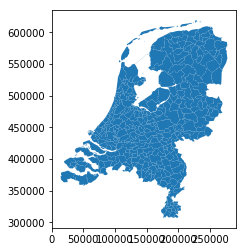

In [9]:
gemeentes.plot()

In [10]:
gemeentes.head()

,id,code,gemeentena,geometry
0,1,0584,Oud-Beijerland,"POLYGON ((86155.55100000001 425626.193, 86155...."
1,18,0160,Hardenberg,"POLYGON ((235753.945 520891.056, 235788.817 52..."
2,19,0327,Leusden,"POLYGON ((156842.831 462252.598, 156843.065 46..."
3,20,1931,Krimpenerwaard,"POLYGON ((104334.072 443036.486, 104342.974 44..."
4,21,1701,Westerveld,"POLYGON ((207869.464 536733.644, 207862.002 53..."


In [11]:
df2 = pd.merge(df1, gemeentes, how='left', left_on='municipality', right_on='gemeentena')
df2.drop('gemeentena', axis = 1,  inplace = True)
df2.head()

,municipality,province,latitude,longitude,surface_km2,surface_land_km2,surface_water_km2,population,avg_household_income_2012,avg_woz_2014,...,asylum_migrants_2011,asylum_migrants_2012,asylum_migrants_2013,asylum_migrants_2014,asylum_migrants_2015,latitude1,latitude2,id,code,geometry
0,Aa en Hunze,Drenthe,53.010.485,6.749.528,278.9,276.4,2.5,25243.0,35500.0,225000.0,...,30.0,30.0,25.0,25.0,20.0,53010485,53.010.485,305,1680,"POLYGON ((239628.702 560674.8419999999, 239622..."
1,Aalburg,Noord-Brabant,51.751.294,5.057.085,53.2,50.4,2.8,12859.0,39100.0,249000.0,...,5.0,5.0,5.0,5.0,5.0,51751294,51.751.294,191,0738,"POLYGON ((133319.663 419859.925, 133342.122 41..."
2,Aalsmeer,Noord-Holland,52.262.164,4.761.922,32.3,20.4,11.9,30792.0,40900.0,276000.0,...,55.0,60.0,60.0,60.0,55.0,52262164,52.262.164,134,0358,"POLYGON ((111106.085 475984.342, 111111.133 47..."
3,Aalten,Gelderland,51.926.667,6.580.678,97.0,96.5,0.5,27030.0,33300.0,194000.0,...,45.0,35.0,35.0,35.0,35.0,51926667,51.926.667,102,0197,"POLYGON ((229935.823 435390.978, 229899.45 435..."
4,Achtkarspelen,Friesland,53.210.357,6.153.565,104.0,102.4,1.6,28002.0,30500.0,165000.0,...,25.0,25.0,25.0,25.0,25.0,53210357,53.210.357,159,0059,"POLYGON ((201481.106 579247.514, 201462.561 57..."


In [12]:
df3 = gp.GeoDataFrame(df2)

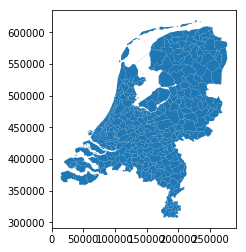

In [13]:
df3.plot()

In [14]:
df3.columns

Index(['municipality', 'province', 'latitude', 'longitude', 'surface_km2',
       'surface_land_km2', 'surface_water_km2', 'population',
       'avg_household_income_2012', 'avg_woz_2014', 'ww_ratio_2014',
       'murders_2014', 'university', 'asylum_migrants_1999',
       'asylum_migrants_2000', 'asylum_migrants_2001', 'asylum_migrants_2002',
       'asylum_migrants_2003', 'asylum_migrants_2004', 'asylum_migrants_2005',
       'asylum_migrants_2006', 'asylum_migrants_2007', 'asylum_migrants_2008',
       'asylum_migrants_2009', 'asylum_migrants_2010', 'asylum_migrants_2011',
       'asylum_migrants_2012', 'asylum_migrants_2013', 'asylum_migrants_2014',
       'asylum_migrants_2015', 'latitude1', 'latitude2', 'id', 'code',
       'geometry'],
      dtype='object')

C:\ProgramData\Anaconda\lib\site-packages\matplotlib\colors.py:504: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


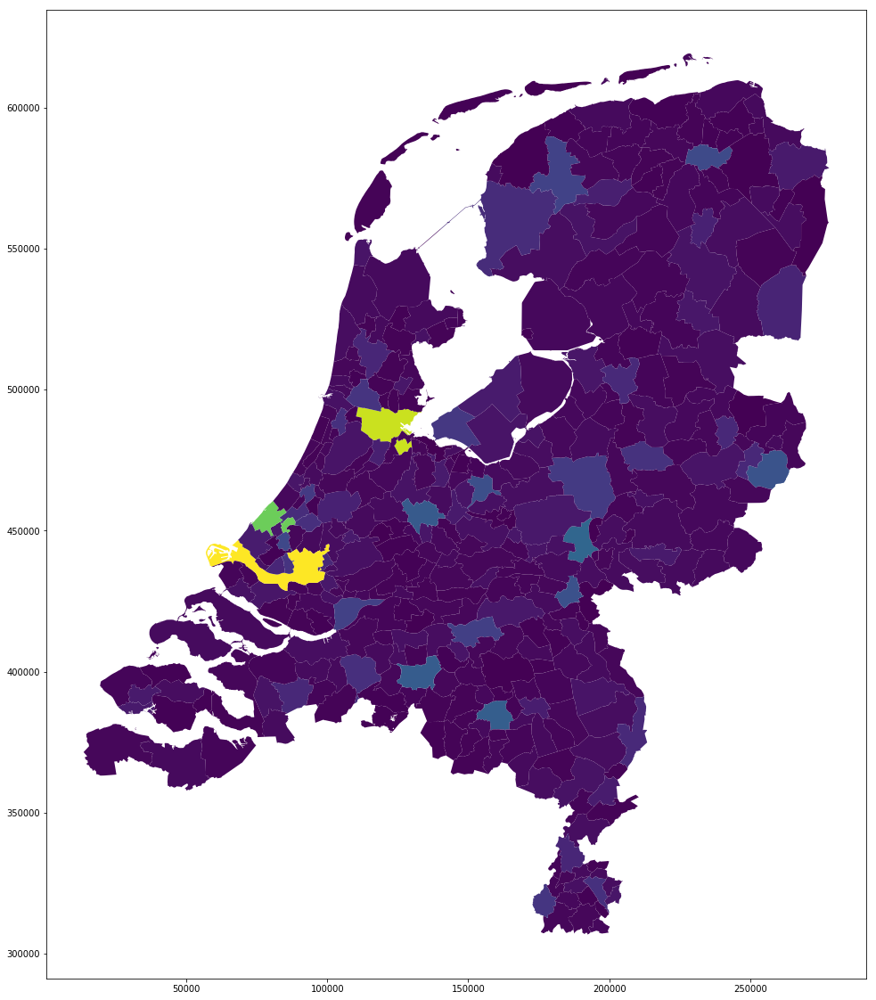

In [15]:
p = df3.plot(column='asylum_migrants_2000', figsize = (20,20))

In [16]:
gemeentes.head()
gemeentes.drop(['id', 'code', 'gemeentena'], axis = 1, inplace = True)


    

In [29]:
from bokeh.models import GeoJSONDataSource
from bokeh.plotting import figure, show, output_notebook
geodf = r".\\data\\2018-Imergis_gemeentegrenzen_kustlijn.json"
output_notebook()

geodf = gpd.read_file(geodf)
geodf.head()

Loading BokehJS ...

,id,code,gemeentena,geometry
0,1,0584,Oud-Beijerland,"POLYGON ((85710.645 426642.09, 85800 426710, 8..."
1,2,0448,Texel,"(POLYGON ((122420.5625 566910.3125, 122422.531..."
2,3,0289,Wageningen,"POLYGON ((178153.007 445868.291, 178152.62 445..."
3,4,0093,Terschelling,"(POLYGON ((139762.7427648949 589553.57256817, ..."
4,5,0268,Nijmegen,"POLYGON ((184605.467 431389.46, 184711.869 431..."


In [18]:
geodf = pd.DataFrame(geodf)
geodf.head()

,id,code,gemeentena,geometry
0,1,0584,Oud-Beijerland,"POLYGON ((85710.645 426642.09, 85800 426710, 8..."
1,2,0448,Texel,"(POLYGON ((122420.5625 566910.3125, 122422.531..."
2,3,0289,Wageningen,"POLYGON ((178153.007 445868.291, 178152.62 445..."
3,4,0093,Terschelling,"(POLYGON ((139762.7427648949 589553.57256817, ..."
4,5,0268,Nijmegen,"POLYGON ((184605.467 431389.46, 184711.869 431..."


In [19]:
df5 = df1[['municipality', 'murders_2014']]
df5.head()

,municipality,murders_2014
0,Aa en Hunze,0
1,Aalburg,0
2,Aalsmeer,0
3,Aalten,0
4,Achtkarspelen,0


In [20]:
geodf_merge = pd.merge(df5, geodf, how = 'left', left_on = 'municipality', right_on = 'gemeentena')
geodf_merge.head()

,municipality,murders_2014,id,code,gemeentena,geometry
0,Aa en Hunze,0,305,1680,Aa en Hunze,"POLYGON ((248063.379 568446.544, 248119.214 56..."
1,Aalburg,0,191,0738,Aalburg,"POLYGON ((133935.545 421382.818, 133960.174 42..."
2,Aalsmeer,0,134,0358,Aalsmeer,"POLYGON ((115625.241 479913.18, 115661.562 479..."
3,Aalten,0,102,0197,Aalten,"POLYGON ((233347.75 442570.514, 233359.267 442..."
4,Achtkarspelen,0,159,0059,Achtkarspelen,"POLYGON ((197232.703 584000.303, 197232.824 58..."


In [21]:
geodf_gpd = gpd.GeoDataFrame(geodf_merge)
geodf_gpd.head()

,municipality,murders_2014,id,code,gemeentena,geometry
0,Aa en Hunze,0,305,1680,Aa en Hunze,"POLYGON ((248063.379 568446.544, 248119.214 56..."
1,Aalburg,0,191,0738,Aalburg,"POLYGON ((133935.545 421382.818, 133960.174 42..."
2,Aalsmeer,0,134,0358,Aalsmeer,"POLYGON ((115625.241 479913.18, 115661.562 479..."
3,Aalten,0,102,0197,Aalten,"POLYGON ((233347.75 442570.514, 233359.267 442..."
4,Achtkarspelen,0,159,0059,Achtkarspelen,"POLYGON ((197232.703 584000.303, 197232.824 58..."


In [30]:
geojson = geodf_gpd.to_json()
geo_source = GeoJSONDataSource(geojson=geojson)
                               
color_column = 'murders_2014'

p = figure(title="Accumulated")
p.patches('xs', 'ys', fill_alpha=0.7,fill_color={'field': color_column, 'transform': LinearColorMapper(palette='Plasma256')},
          line_color='black', line_width=0.5, source=geo_source)
show(p)



In [31]:
from bokeh.models import HoverTool
my_hover = HoverTool()
my_hover.tooltips = [('Municipality:', '@gemeentena'), ('Aantal moorden', '@murders_2014')]

In [32]:
p.add_tools(my_hover)
show(p)

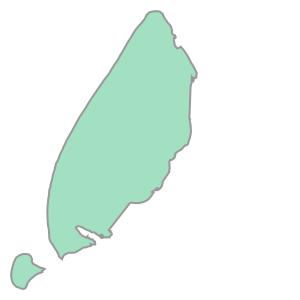

In [25]:
gemeentes['geometry'][9]

In [26]:
def getPolyCoords(row, geom, coord_type):
    """Returns the coordinates ('x' or 'y') of edges of a Polygon exterior"""

    # Parse the exterior of the coordinate
    exterior = row[geom].exterior

    if coord_type == 'x':
        # Get the x coordinates of the exterior
        return list( exterior.coords.xy[0] )
    elif coord_type == 'y':
        # Get the y coordinates of the exterior
        return list( exterior.coords.xy[1] )


In [27]:
gemeentes['x'] = gemeentes.apply(getPolyCoords, geom='geometry', coord_type='x', axis=1)
gemeentes['y'] = gemeentes.apply(getPolyCoords, geom='geometry', coord_type='y', axis=1)

AttributeError: ("'MultiPolygon' object has no attribute 'exterior'", 'occurred at index 9')

In [ ]:
from bokeh.models import HoverTool
my_hover = HoverTool()
my_hover.tooltips = [('Municipality:', '@municipality')]

In [ ]:
p.add_tools(my_hover)
p